In [1]:
from dendrocat import RadioSource, MasterCatalog
from astropy.io import fits
from spectral_cube import SpectralCube
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
import numpy as np
import sys
import importlib
from astropy.wcs import WCS
from regions import Regions, PixCoord
from astropy import stats
from itertools import chain
import dendrocat
from scipy import stats
import Paths.Paths as paths
Path = paths.filepaths()









/home/t.yoo/anaconda3/lib/python3.9/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.26.4
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [2]:
from astropy.nddata.utils import Cutout2D, NoOverlapError
from astropy import coordinates, wcs
import astropy.units as u
from matplotlib import colors
from matplotlib.patches import Rectangle, Ellipse
from radio_beam import Beam
import matplotlib.patches as patches
from matplotlib.gridspec import GridSpec

def get_cutout(image_dir, xpos, ypos, fwhm):
    fitsdata = fits.open(image_dir)
    wcs_image = WCS(fitsdata[0].header,naxis=2)
    image = fitsdata[0].data[0][0]
    if len(image.shape)>2:
        image = fitsdata[0].data[0][0]
    x_cen = xpos * u.deg
    y_cen = ypos * u.deg
    position = coordinates.SkyCoord(x_cen, y_cen,
                                    frame=wcs.utils.wcs_to_celestial_frame(wcs_image).name,
                                    unit=(u.deg, u.deg))
    pixel_scale = (np.abs(wcs_image.pixel_scale_matrix.diagonal().prod())**0.5 * u.deg)
    size = 10*fwhm
        #size = 24*pixel_scale + 2.5*fwhm * u.deg
    
    cutout = Cutout2D(image,
                          position,
                      size,
                      wcs=wcs_image,
                      mode='partial')
     

  
    return cutout

def add_scale_bar(ax, xpos,ypos,scale, pixel_scale, dist, unit='pc',height=20,color='w',pad=40,size=40):
    phy_pix_scale = pixel_scale.value * np.pi/180 * dist
    ax.add_patch(Rectangle((xpos,ypos),scale/phy_pix_scale,height,color=color))
    ax.text(xpos+0.4*scale/phy_pix_scale, ypos+pad, '%2.1f %s'%(scale, unit), color=color,fontsize=size)
                
def add_beam(ax,xpos,ypos,beam, pixel_scale,color='w'):
    width = beam.major / pixel_scale
    height = beam.minor /pixel_scale
    angle = beam.pa
    ax.add_patch(Ellipse((xpos,ypos),width.value,height.value,180-angle.value,color=color))

def plot_cutouts(ax, image_dir, xpos, ypos, fwhm, cmap='inferno', 
                 addbeam=True, scale=None, dist=None, 
                 vmin=-0.00010907209521789237, vmax=0.01065474459299, sqrtpower=True,
                label=None, mmlabel=None, nomatch=False,fontcolor='w',
                ):
    
    cutout = get_cutout(image_dir, xpos, ypos, fwhm)
    shape = cutout.data.shape
    hdr = fits.getheader(image_dir)  
    wcs = WCS(hdr,naxis=2)
    pixel_scale = wcs.proj_plane_pixel_scales()[0]
    beam = Beam.from_fits_header(hdr)
    midpoint = int(shape[0]/2)

    beamsize_pix = beam.major.to(u.deg).value / pixel_scale

    if sqrtpower:
        vmax = np.nanmax(cutout.data[midpoint-int(2*beamsize_pix.value):midpoint+int(2*beamsize_pix.value), midpoint-int(2*beamsize_pix.value):midpoint+int(2*beamsize_pix.value)])
        ax.imshow(cutout.data, origin='lower', cmap=plt.get_cmap(cmap), 
              norm=colors.PowerNorm(gamma=0.5, vmin=np.min(cutout.data[np.isfinite(cutout.data)]), 
                                    vmax=1.5*vmax),aspect='equal')
    else:
        
        ax.imshow(cutout.data, origin='lower', cmap=plt.get_cmap(cmap), 
              vmin=vmin, vmax=vmax,aspect='auto')
    if addbeam:
        add_beam(ax, 0.15*shape[0], 0.15*shape[1], beam, pixel_scale)
    if scale is not None:
        add_scale_bar(ax, 0.8*shape[0], 0.2*shape[1], scale, pixel_scale, dist)
    if label is not None:
        ax.text(0.08*shape[0],0.85*shape[1], label, color=fontcolor, fontsize=35)
   
        
    #if mmlabel is not None:
    #    ax.text(0.65*shape[0],0.85*shape[1], mmlabel, color=mmlabelcolor, fontsize=25)
    ax.set_xticks([])
    ax.set_yticks([])
    return cutout.data


def plot_set_cutouts(table_fin, b3file, b6file, savedir='', 
startnum=0,  nrow=9, ncol=4, margin = 0.01, top = 0.98, bottom = 0.02,
wspace=0.00, hspace=0.00, additional_row=0, endnum=None):
    
    hdr_b3 = fits.getheader(b3file)
    hdr_b6 = fits.getheader(b6file)

    beam_b3 = Beam.from_fits_header(hdr_b3)    
    beam_b6 = Beam.from_fits_header(hdr_b6)
    size = (beam_b3.major+beam_b6.major)/2   

    if endnum is None:
        endnum = len(table_fin['b3_xsky'])
    endendnum = len(table_fin['b3_xsky'])
    print('endnum', endnum)
    print('endendnum', endendnum)
    width = (1 - margin*ncol)/ncol
    height = (top-bottom-5*margin)/(nrow+additional_row)
    ratio = width/2/height
    bottom = top - height * nrow
    figsize=40
    fig = plt.figure(figsize=(figsize,figsize*ratio))
    if nrow >0:
        for icol in range(ncol):
            gs = GridSpec(nrow, 2, left=(icol+1)*margin+icol*width, right=(icol+1)*(margin+width), 
                        wspace=wspace, hspace=hspace, top=top, bottom=bottom)
            for irow in range(nrow):
                obsnum = icol * nrow + irow + startnum
                print('obsnum',obsnum)
                if obsnum > endnum:
                    continue
                obsnum_final = obsnum
                ax1 = fig.add_subplot(gs[irow,0])
                ax2 = fig.add_subplot(gs[irow,1])
                ax1.set_aspect('auto')
                ax2.set_aspect('auto')
                ax1.xaxis.set_major_locator(plt.NullLocator())
                ax1.yaxis.set_major_locator(plt.NullLocator())
                ax2.xaxis.set_major_locator(plt.NullLocator())
                ax2.yaxis.set_major_locator(plt.NullLocator())

                if irow == 0:
                    ax1.set_title('3 mm', fontsize=40)
                    ax2.set_title('1.3 mm', fontsize=40)

                xpos_b3 = table_fin['b3_xsky'][obsnum]
                ypos_b3 = table_fin['b3_ysky'][obsnum]
                #fwhm_b3 = table_fin['b3_afwhm'][obsnum]
                
                xpos_b6 = table_fin['b6_xsky'][obsnum]
                ypos_b6 = table_fin['b6_ysky'][obsnum]
                #fwhm_b6 = table_fin['b6_afwhm'][obsnum]
                
                isoverlap = table_fin['is_overlap'][obsnum]
                
                b3id = table_fin['b3_id'][obsnum]
                b6id = table_fin['b6_id'][obsnum]
                b3continue=True ; b6continue=True
                nomatch_b3 = False ; nomatch_b6 = False
                print(obsnum, xpos_b3, ypos_b3, xpos_b6, ypos_b6, b3id, b6id)

                if not isoverlap: # if B3 positions are out of the FoV of B6, then just skip drawing
                    if xpos_b3 < 0 or ypos_b3 <0:
                        b3continue=False
                    if xpos_b6 < 0 or ypos_b6 <0:
                        b6continue=False
                else:
                    if xpos_b3 < 0 or ypos_b3 <0:
                        xpos_b3 = xpos_b6 ; ypos_b3 = ypos_b6
                        nomatch_b3=True
                    if xpos_b6 < 0 or ypos_b6 <0:
                        xpos_b6 = xpos_b3 ; ypos_b6 = ypos_b3
                        nomatch_b6=True
                if b3continue:
                    b3arr = plot_cutouts(ax1, b3file, xpos_b3, ypos_b3, size,label='#%d'%(obsnum), mmlabel='3 mm', nomatch=nomatch_b3)
                    
                if b6continue:
                    b6arr = plot_cutouts(ax2, b6file, xpos_b6, ypos_b6, size, mmlabel='1.3 mm',nomatch=nomatch_b6)
                if nomatch_b3:
                    rect = patches.Rectangle((0.02*b3arr.shape[1], 0.02*b3arr.shape[0]), 0.96*b3arr.shape[1], 0.96*b3arr.shape[0], linewidth=30, edgecolor='cyan', facecolor='none')
                    ax1.add_patch(rect)

                if nomatch_b6:
                    rect = patches.Rectangle((0.02*b6arr.shape[1], 0.02*b6arr.shape[0]), 0.96*b6arr.shape[1], 0.96*b6arr.shape[0], linewidth=30, edgecolor='cyan', facecolor='none')
                    ax2.add_patch(rect)
        print('obsnum_final, endnum',obsnum_final, endnum)
        print('endnum',endnum)   
    if additional_row > 0:
        top_add = bottom - 5*margin
        bottom_add = top_add - additional_row * height
        print('height',height)
        print('top_add', top_add)
        print('bottom_add', bottom_add)
        print('margin', margin)
        gs_add = GridSpec(additional_row, ncol*2, left=margin, right=1-margin,wspace=0.0, hspace=0.0, top=top_add, bottom=bottom_add)
        print('endnum', endnum)
        print('endendnum', endendnum)
        arr = np.arange(endnum+1, endendnum)
        print('arr', arr)
        for num in arr:
            ind = num - endnum - 1

            xind = ind % (ncol*2) 
            yind = ind // (ncol*2)
            print('ind, xind, yind', ind, xind, yind)
            ax = fig.add_subplot(gs_add[yind,xind])
            if ind==0:
                ax.set_title('3 mm', fontsize=40)
            #ax.set_aspect('auto')
            ax.xaxis.set_major_locator(plt.NullLocator())
            ax.yaxis.set_major_locator(plt.NullLocator())
            xpos_b3 = table_fin['b3_xsky'][num]
            ypos_b3 = table_fin['b3_ysky'][num]
            b3arr = plot_cutouts(ax, b3file, xpos_b3, ypos_b3, size,label='#%d'%(num), mmlabel='3 mm', nomatch=True)
                



    print('plot saved to ', savedir)
    plt.savefig(savedir)
    

             
def plot_set_cutouts_single(table_fin, b3file, b6file, savedir='', 
startnum=0,  nrow=9, ncol=4, margin = 0.01, top = 0.98, bottom = 0.02,
wspace=0.00, hspace=0.00, endnum=None, different_font_color_ind=[]):

    hdr_b3 = fits.getheader(b3file)
    hdr_b6 = fits.getheader(b6file)

    beam_b3 = Beam.from_fits_header(hdr_b3)    
    beam_b6 = Beam.from_fits_header(hdr_b6)

    if endnum is None:
        endnum = len(table_fin['b3_xsky'])

    width = (1 - margin*ncol)/ncol
    height = (top-bottom)/nrow
    ratio = width/height
    figsize=40
    fig = plt.figure(figsize=(figsize,figsize*ratio))

    gs = GridSpec(nrow, ncol, left=margin, right=1-margin, 
                    wspace=wspace, hspace=hspace, top=top, bottom=bottom)
    
    for irow in range(nrow):
        for icol in range(ncol):
            obsnum = irow * ncol + icol + startnum
            print('obsnum',obsnum)
            #print(obsnum, xpos_b3, ypos_b3,  b3id)


            ax1 = fig.add_subplot(gs[irow,icol])
            #ax2 = fig.add_subplot(gs[irow,icol])
            ax1.set_aspect('auto')
            #ax2.set_aspect('auto')

            ax1.xaxis.set_major_locator(plt.NullLocator())
            ax1.yaxis.set_major_locator(plt.NullLocator())

            if obsnum > endnum:
                continue

           
           


            if irow == 0 and icol == 0:
                ax1.set_title('3 mm', fontsize=40)
            #    ax2.set_title('1.3 mm', fontsize=40)

            xpos_b3 = table_fin['b3_xsky'][obsnum]
            ypos_b3 = table_fin['b3_ysky'][obsnum]
            #fwhm_b3 = table_fin['b3_afwhm'][obsnum]
            
            #xpos_b6 = table_fin['b6_xsky'][obsnum]
            #ypos_b6 = table_fin['b6_ysky'][obsnum]
            #fwhm_b6 = table_fin['b6_afwhm'][obsnum]
            
            isoverlap = table_fin['is_overlap'][obsnum]
            
            b3id = table_fin['b3_id'][obsnum]
            #b6id = table_fin['b6_id'][obsnum]
            b3continue=True ; b6continue=True
            nomatch_b3 = False ; nomatch_b6 = False

            if not isoverlap: # if B3 positions are out of the FoV of B6, then just skip drawing
                if xpos_b3 < 0 or ypos_b3 <0:
                    b3continue=False
            #      if xpos_b6 < 0 or ypos_b6 <0:
            #          b6continue=False
            else:
                if xpos_b3 < 0 or ypos_b3 <0:
                    xpos_b3 = xpos_b6 ; ypos_b3 = ypos_b6
                    nomatch_b3=True
            #      if xpos_b6 < 0 or ypos_b6 <0:
            #          xpos_b6 = xpos_b3 ; ypos_b6 = ypos_b3
            #          nomatch_b6=True
            size = (beam_b3.major+beam_b6.major)/2   
            if b3continue:
                if obsnum in different_font_color_ind:
                    fontcolor = 'k'
                else:
                    fontcolor = 'w'
                b3arr = plot_cutouts(ax1, b3file, xpos_b3, ypos_b3, size,label='#%d'%(obsnum), mmlabel='3 mm', nomatch=nomatch_b3, fontcolor=fontcolor)
                
            #if b6continue:
            #    b6arr = plot_cutouts(ax2, w51e_b6_calibrated_pbcor, xpos_b6, ypos_b6, size, mmlabel='1.3 mm',nomatch=nomatch_b6)
            if nomatch_b3:
                rect = patches.Rectangle((0.02*b3arr.shape[1], 0.02*b3arr.shape[0]), 0.96*b3arr.shape[1], 0.96*b3arr.shape[0], linewidth=30, edgecolor='cyan', facecolor='none')
                ax1.add_patch(rect)

            #if nomatch_b6:
            #    rect = patches.Rectangle((0.05*b6arr.shape[1], 0.05*b6arr.shape[1]), 0.9*b6arr.shape[1], 0.9*b6arr.shape[0], linewidth=30, edgecolor='r', facecolor='none')
            #    ax2.add_patch(rect)
    plt.savefig(savedir)       
    plt.show()     


118
endnum 118
endendnum 118
obsnum 0
0 290.9323236580427 14.505409165819163 290.93232480562904 14.50541222136782 93030993 226003756
obsnum 1
1 290.9323698526286 14.505461665938908 290.932371860991 14.505463332600574 93031160 226003903
obsnum 2
2 290.9324542082429 14.505457777245084 290.932455642757 14.505459999460392 93031210 226003934
obsnum 3
3 290.9324642504769 14.50550249948864 290.9324648242179 14.505505555035423 93031450 226004041
obsnum 4
4 290.93224934308944 14.505939998942365 290.9322524991548 14.505941110052976 93033120 226005282
obsnum 5
5 290.932584757782 14.505932221933161 290.9325841838294 14.505934444144511 93033295 226005298
obsnum 6
6 290.93261086786623 14.50595749975086 290.93261402393324 14.505958888634384 93033484 226005328
obsnum 7
7 290.93127523365786 14.50606249401039 290.9312758073839 14.506065549560057 93034136 226005550
obsnum 8
8 290.9323598082871 14.506204443693052 290.93236152972986 14.506206665909666 93034470 226005765
obsnum 9
9 290.93248031666974 14.506

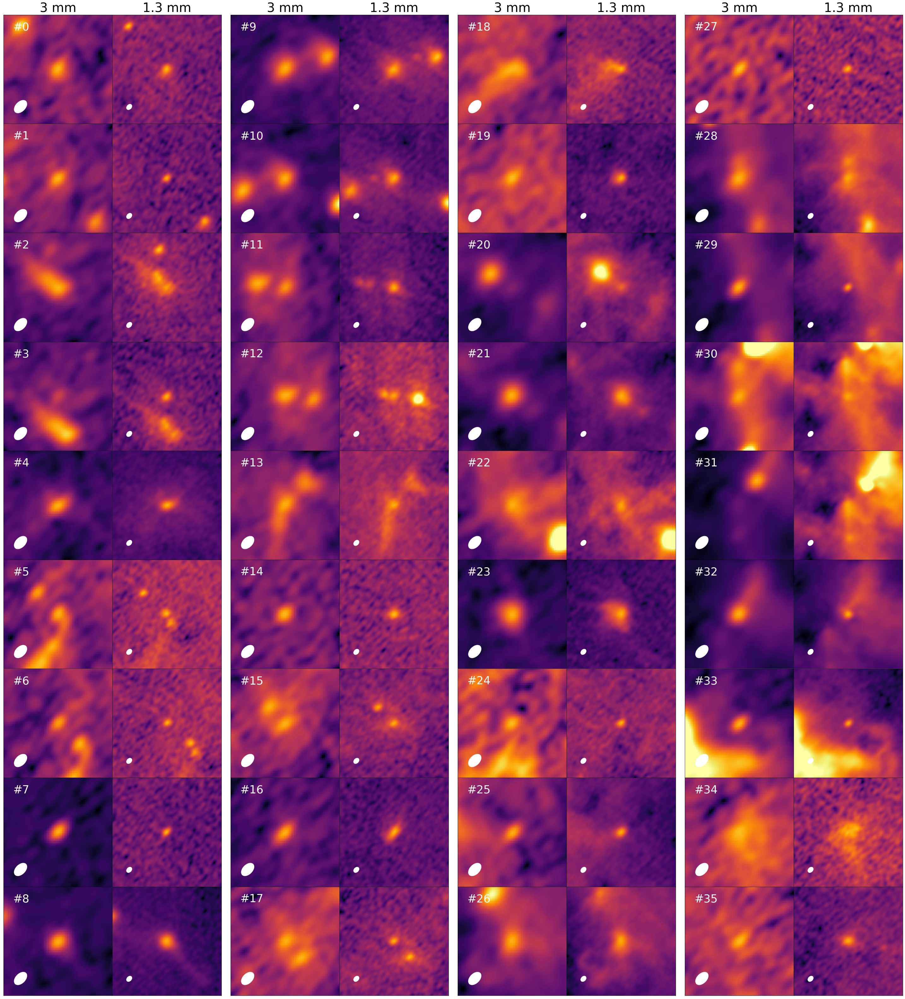

In [3]:
from astropy.table import Table
table_w51e = Table.read(Path.w51e_dendro_matched_catalog_new)
print(len(table_w51e))
    
#table_w51e = Table.read('/home/t.yoo/w51/w51_frag_new/dendro/tables/dendro_w51e_matched_duplicated_removed.fits')

plot_set_cutouts(table_w51e, Path.w51e_b3_tt0, Path.w51e_b6_tt0,nrow=9,savedir='w51e_snapshot-1.png')


endnum 118
endendnum 118
obsnum 36
36 290.9333017870279 14.50920472198142 290.9333003522858 14.509205555306854 93042746 226009319
obsnum 37
37 290.93388626101455 14.50926888707522 290.93388913020686 14.509269998165058 93042948 226009427
obsnum 38
38 290.93365930048736 14.509307776746626 290.93364811016716 14.509308887880692 93043037 226009483
obsnum 39
39 290.9331873028754 14.509581944342363 290.9331924675019 14.509583333216197 93043756 226009874
obsnum 40
40 290.93316119236573 14.50963055547734 290.9331637746304 14.509632222131787 93043890 226009956
obsnum 41
41 290.93242206256986 14.509671388289053 290.93242464482876 14.50967333272936 93044010 226010023
obsnum 42
42 290.93306880121185 14.509747222205275 290.9330719573353 14.509747777749356 93044158 226010095
obsnum 43
43 290.93330178795094 14.509799721981429 290.93330379635927 14.509801110857401 93044279 226010182
obsnum 44
44 290.9314338765924 14.509893050645397 290.931436458849 14.509894439540947 93044556 226010321
obsnum 45
45 290

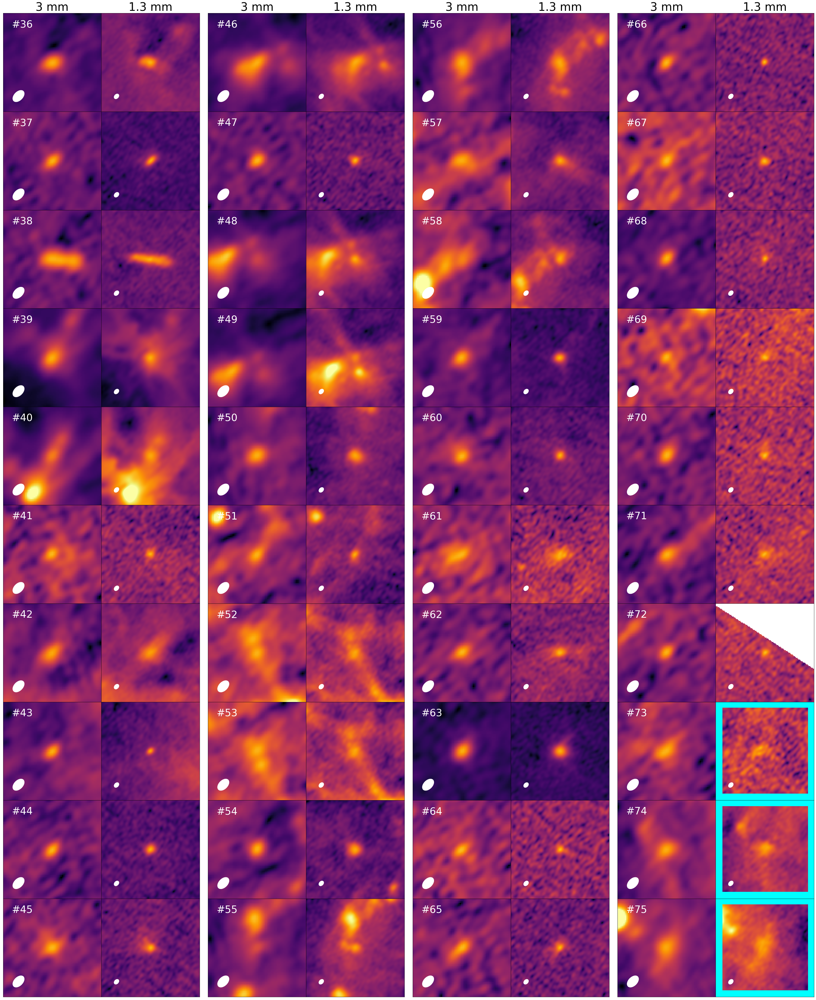

In [4]:
plot_set_cutouts(table_w51e, Path.w51e_b3_tt0,  Path.w51e_b6_tt0,startnum=36, nrow=10,savedir='w51e_snapshot-2.png')


endnum 106
endendnum 118
obsnum 76
76 290.9285657727739 14.507666625834712 -1.0 -1.0 93037776 --
obsnum 77
77 290.93231360702663 14.5083919435734 -1.0 -1.0 93040273 --
obsnum 78
78 290.92857780846106 14.508436626058646 -1.0 -1.0 93040520 --
obsnum 79
79 290.93352272116846 14.508835277112416 -1.0 -1.0 93041788 --
obsnum 80
80 290.934824232447 14.509424437084 -1.0 -1.0 93043377 --
obsnum 81
81 290.93283782297726 14.509898888867031 -1.0 -1.0 93044573 --
obsnum 82
82 290.9325927846875 14.510159444170505 -1.0 -1.0 93045213 --
obsnum 83
83 290.93302662272293 14.510169166665685 -1.0 -1.0 93045226 --
obsnum 84
84 290.931048229744 14.511458325619975 -1.0 -1.0 93048355 --
obsnum 85
85 -1.0 -1.0 290.9324544932972 14.506235555015186 -- 226005835
obsnum 86
86 -1.0 -1.0 290.93230299395805 14.50725888797809 -- 226007281
obsnum 87
87 -1.0 -1.0 290.9305137189235 14.507577765126674 -- 226007670
obsnum 88
88 -1.0 -1.0 290.9329147204452 14.507659999994514 -- 226007759
obsnum 89
89 -1.0 -1.0 290.9324866253

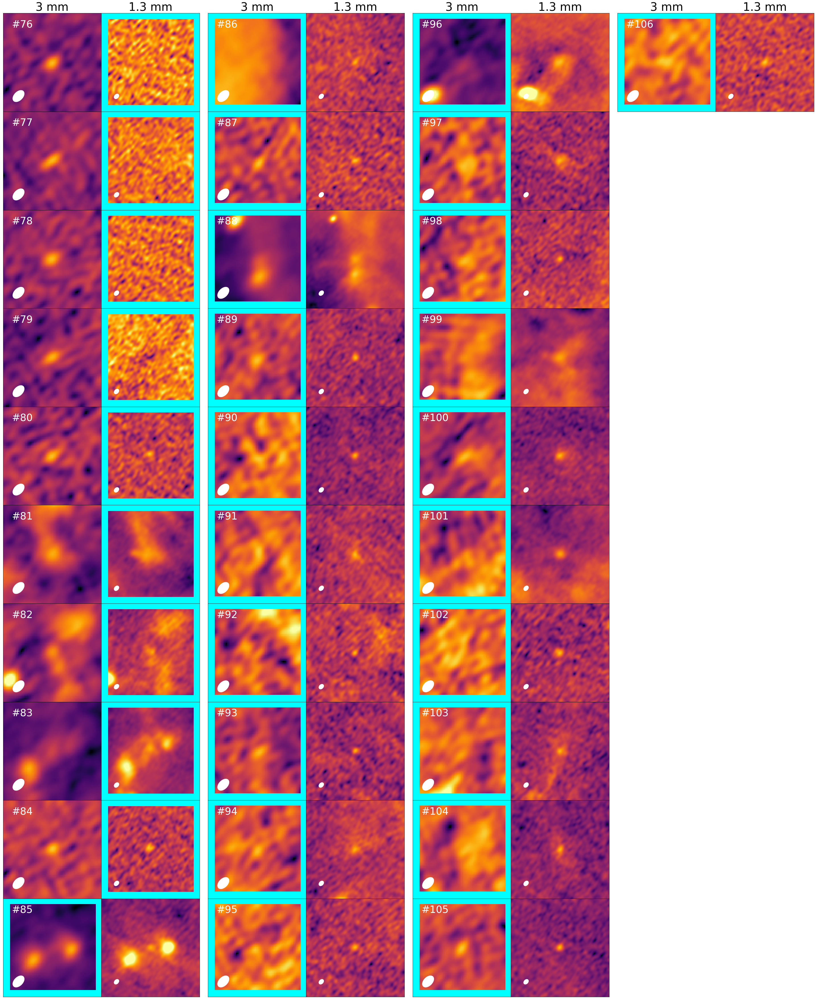

In [5]:
plot_set_cutouts(table_w51e, Path.w51e_b3_tt0, Path.w51e_b6_tt0,startnum=76, nrow=10, endnum=106, savedir='w51e_snapshot-3.png')


endnum 106
endendnum 118
height 0.43499999999999994
top_add 0.8899999999999999
bottom_add 0.020000000000000018
margin 0.01
endnum 106
endendnum 118
arr [107 108 109 110 111 112 113 114 115 116 117]
ind, xind, yind 0 0 0
ind, xind, yind 1 1 0
ind, xind, yind 2 2 0
ind, xind, yind 3 3 0
ind, xind, yind 4 4 0
ind, xind, yind 5 5 0
ind, xind, yind 6 6 0
ind, xind, yind 7 7 0
ind, xind, yind 8 0 1
ind, xind, yind 9 1 1
ind, xind, yind 10 2 1
plot saved to  w51e_snapshot-4.png


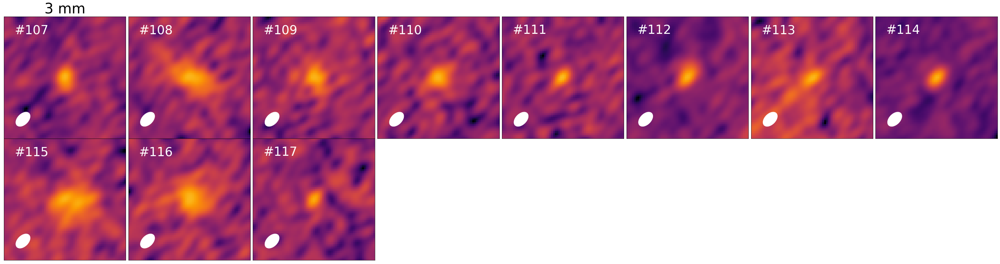

In [6]:
plot_set_cutouts(table_w51e, Path.w51e_b3_tt0, Path.w51e_b6_tt0,startnum=107, ncol=4,nrow=0, endnum=106, additional_row =2,savedir='w51e_snapshot-4.png',top=0.94)


In [7]:
#plot_set_cutouts_single(table_w51e, Path.w51e_b3_tt0, Path.w51e_b6_tt0,startnum=116, nrow=3, ncol=7, savedir='w51e_snapshot-4.png',top = 0.94)


93
endnum 93
endendnum 93
obsnum 0
0 290.9146520640484 14.517598602530239 290.9146540877684 14.517602211771774 93059488 226008542


obsnum 1
1 290.9149573660281 14.517820271604664 290.91496053732016 14.517822214455654 93059666 226008838
obsnum 2
2 290.91711257137194 14.517894166260028 290.9171148817953 14.51789666654037 93059791 226008942
obsnum 3
3 290.91819318735975 14.517917495079438 290.9181960716602 14.517921107410602 93059865 226008996
obsnum 4
4 290.9159074232162 14.518008887682536 290.9159051424691 14.518013331336828 93059989 226009127
obsnum 5
5 290.9155097237706 14.518100274957531 290.9155103123461 14.518102218273638 93060140 226009258
obsnum 6
6 290.91586725127314 14.51810027643882 290.9158649704496 14.518102220057278 93060175 226009324
obsnum 7
7 290.9156342557767 14.518109997757158 290.91563541821677 14.51811333007475 93060197 226009340
obsnum 8
8 290.91618259850935 14.518125555073759 290.91618519565134 14.518126665654504 93060212 226009358
obsnum 9
9 290.9159556287268 14.518141110054858 290.915956791138 14.518145553765578 93060188 226009373
obsnum 10
10 290.91647986858015 14.518150833273886 290.916482

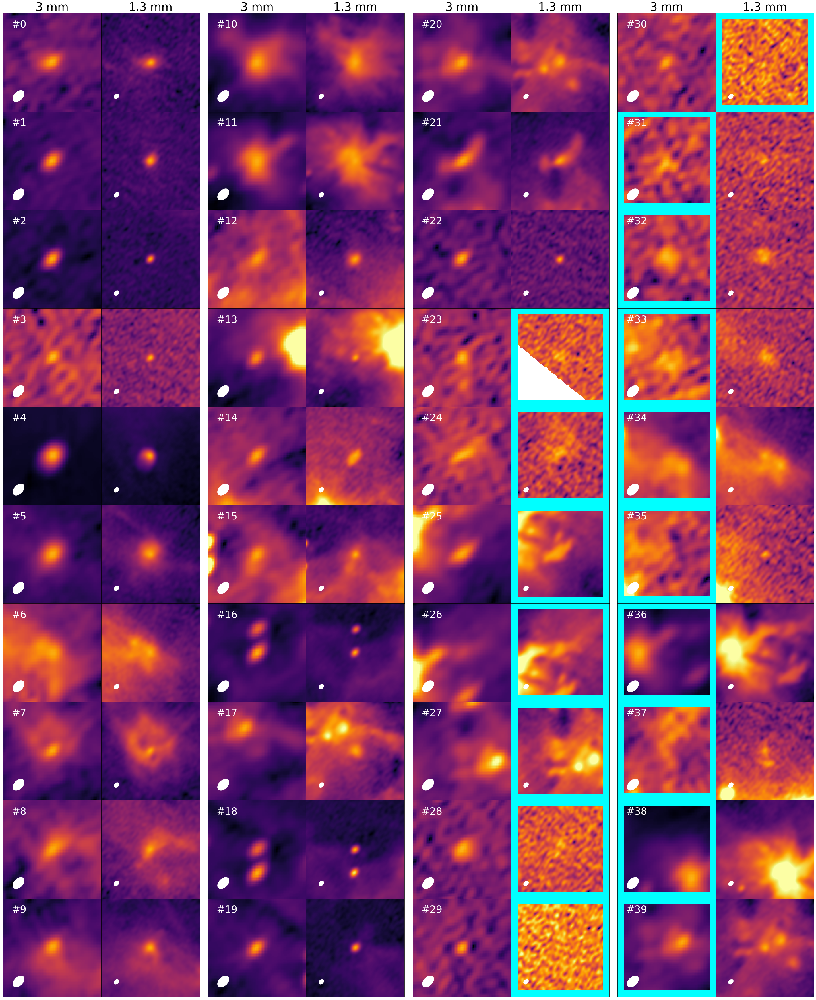

In [8]:
table_w51n = Table.read(Path.w51n_dendro_matched_catalog_new)
print(len(table_w51n))
hdr_b3 = fits.getheader(Path.w51n_b3_tt0)
hdr_b6 = fits.getheader(Path.w51n_b6_tt0)

beam_b3 = Beam.from_fits_header(hdr_b3)    
beam_b6 = Beam.from_fits_header(hdr_b6)    


plot_set_cutouts(table_w51n, Path.w51n_b3_tt0, Path.w51n_b6_tt0, nrow=10, ncol=4,savedir='w51n_snapshot-1.png')


endnum 41
endendnum 93
obsnum 40
40 -1.0 -1.0 290.9164973843033 14.519494444138124 -- 226011389
obsnum 41
41 -1.0 -1.0 290.91686811338957 14.519558888884472 -- 226011472
obsnum 42
obsnum 43
obsnum_final, endnum 41 41
endnum 41
height 0.10874999999999999
top_add 0.7812499999999999
bottom_add 0.020000000000000018
margin 0.01
endnum 41
endendnum 93
arr [42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65
 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89
 90 91 92]
ind, xind, yind 0 0 0
ind, xind, yind 1 1 0
ind, xind, yind 2 2 0


ind, xind, yind 3 3 0
ind, xind, yind 4 4 0
ind, xind, yind 5 5 0
ind, xind, yind 6 6 0
ind, xind, yind 7 7 0
ind, xind, yind 8 0 1
ind, xind, yind 9 1 1
ind, xind, yind 10 2 1
ind, xind, yind 11 3 1
ind, xind, yind 12 4 1
ind, xind, yind 13 5 1
ind, xind, yind 14 6 1
ind, xind, yind 15 7 1
ind, xind, yind 16 0 2
ind, xind, yind 17 1 2
ind, xind, yind 18 2 2
ind, xind, yind 19 3 2
ind, xind, yind 20 4 2
ind, xind, yind 21 5 2
ind, xind, yind 22 6 2
ind, xind, yind 23 7 2
ind, xind, yind 24 0 3
ind, xind, yind 25 1 3
ind, xind, yind 26 2 3
ind, xind, yind 27 3 3
ind, xind, yind 28 4 3
ind, xind, yind 29 5 3
ind, xind, yind 30 6 3
ind, xind, yind 31 7 3
ind, xind, yind 32 0 4
ind, xind, yind 33 1 4
ind, xind, yind 34 2 4
ind, xind, yind 35 3 4
ind, xind, yind 36 4 4
ind, xind, yind 37 5 4
ind, xind, yind 38 6 4
ind, xind, yind 39 7 4
ind, xind, yind 40 0 5
ind, xind, yind 41 1 5
ind, xind, yind 42 2 5
ind, xind, yind 43 3 5
ind, xind, yind 44 4 5
ind, xind, yind 45 5 5
ind, xind, yind 46

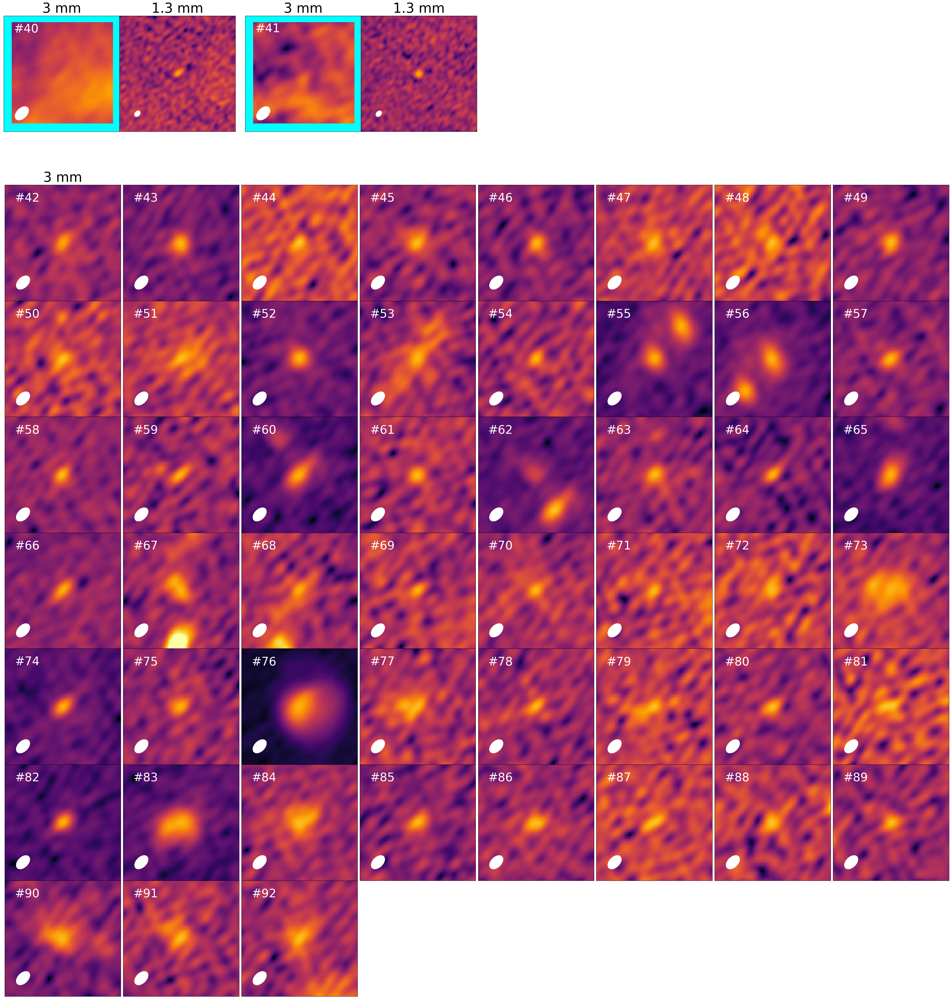

In [9]:
plot_set_cutouts(table_w51n, Path.w51n_b3_tt0, Path.w51n_b6_tt0,startnum=40, nrow=1, ncol=4,additional_row=7, endnum=41,savedir='w51n_snapshot-2.png',top = 0.94)
